# Query for Spectraction Results in OGA

 work with Weakly_2023_35
- use jupyter kernel LSST
- author : Sylvie Dagoret-Campagne
- affiliation : IJCLab
- creation date : 2023/09/06
- last update : 2023/09/06

- Spectractor https://github.com/lsst/Spectractor/
- Spectractor Version 2.5


Implement

- add exposure info in hdf5 attribute to get azimuth



In [1]:
! eups list -s | grep LOCAL

analysis_tools        LOCAL:/home/d/dagoret/repos/repos_w_2023_35/analysis_tools 	setup
atmospec              LOCAL:/home/d/dagoret/repos/repos_w_2023_35/atmospec 	setup
eups                  LOCAL:/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-7.0.1/eups 	setup
spectractor           LOCAL:/home/d/dagoret/repos/repos_w_2023_35/Spectractor 	setup


In [2]:
! eups list -s lsst_distrib

   g4213664e8e+c55b99ec95 	current w_2023_35 setup


In [3]:
import h5py

In [4]:
import lsst.daf.butler as dafButler
#import lsst.summit.utils.butlerUtils as butlerUtils

In [5]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LogNorm
import pandas as pd

import matplotlib.ticker                         # here's where the formatter is
import os
import re
import pandas as pd

plt.rcParams["figure.figsize"] = (4,3)
plt.rcParams["axes.labelsize"] = 'xx-large'
plt.rcParams['axes.titlesize'] = 'xx-large'
plt.rcParams['xtick.labelsize']= 'xx-large'
plt.rcParams['ytick.labelsize']= 'xx-large'

In [6]:
from astropy.time import Time
import astropy.units as u

## Config

In [7]:
FLAG_MOUNT_ERRORS= False

### Butler

In [8]:
#repo =  "/sdf/group/rubin/repo/main"
repo = "/sdf/group/rubin/repo/oga/"
#repo = "/repo/embargo/"
butler = dafButler.Butler(repo)
registry = butler.registry

## User collections

In [9]:
DateToRuncollection_rebin2 = {
 # January 2023
 20230117 :  "u/dagoret/BPS_manyspectro_v100", 
 20230118 :  "u/dagoret/BPS_manyspectro_v102", 
 20230119 :  "u/dagoret/BPS_manyspectro_v104",  
 20230131 :  "u/dagoret/BPS_manyspectro_v106",  
    
# Feb 2023
 20230201 :  "u/dagoret/BPS_manyspectro_v108", 
 20230202 :  "u/dagoret/BPS_manyspectro_v110", 
 20230214 :  "u/dagoret/BPS_manyspectro_v112", 
 20230215 :  "u/dagoret/BPS_manyspectro_v114", 
 20230216 :  "u/dagoret/BPS_manyspectro_v116", 
 20230228 :  "u/dagoret/BPS_manyspectro_v118",  
    
# March 2023    
 20230301 :  "u/dagoret/BPS_manyspectro_v120", 
 20230302 :  "u/dagoret/BPS_manyspectro_v122",
 20230315 :  "u/dagoret/BPS_manyspectro_v124", 
 20230316 :  "u/dagoret/BPS_manyspectro_v126",  
    
    
# May 2023
20230509 :  "u/dagoret/BPS_manyspectro_v128", 
20230510 :  "u/dagoret/BPS_manyspectro_v130",
20230511 :  "u/dagoret/BPS_manyspectro_v132",     
    
    
 # July 2023
 20230718 :  "u/dagoret/BPS_manyspectro_v96", 
 20230720 :  "u/dagoret/BPS_manyspectro_v98",
    
 # August 2023    
 20230801 : "u/dagoret/BPS_manyspectro_v134",
 20230802 : "u/dagoret/BPS_manyspectro_v136",   
 20230815 : "u/dagoret/BPS_manyspectro_v138", 
 #20230817 : "u/dagoret/BPS_manyspectro_v140",
  20230817 : "u/dagoret/BPS_manyspectro_v140b", 
    
    
# September 2023    
  20230912 : "u/dagoret/BPS_manyspectro_v150",
# 20230912 : "u/dagoret/BPS_manyspectro_v152", 
    
    
}
DateToRuncollection_rebin1 = {
 # January 2023
 20230117 :  "u/dagoret/BPS_manyspectro_v101", 
 20230118 :  "u/dagoret/BPS_manyspectro_v103",  
 20230119 :  "u/dagoret/BPS_manyspectro_v105",  
 20230131:  "u/dagoret/BPS_manyspectro_v107",  
    
# February    
 20230201:  "u/dagoret/BPS_manyspectro_v109",  
 20230202:  "u/dagoret/BPS_manyspectro_v111",  
    
 20230214 :  "u/dagoret/BPS_manyspectro_v113", 
 20230215 :  "u/dagoret/BPS_manyspectro_v115", 
 20230216 :  "u/dagoret/BPS_manyspectro_v117", 
 20230228 :  "u/dagoret/BPS_manyspectro_v119",  
    
    
# March 2023    
 20230301 :  "u/dagoret/BPS_manyspectro_v121", 
 20230302 :  "u/dagoret/BPS_manyspectro_v123",
 20230315 :  "u/dagoret/BPS_manyspectro_v125", 
 20230316 :  "u/dagoret/BPS_manyspectro_v127",  
    
    
# May 2023
20230509 :  "u/dagoret/BPS_manyspectro_v129", 
20230510 :  "u/dagoret/BPS_manyspectro_v131",
20230511 :  "u/dagoret/BPS_manyspectro_v133",     
    
    
 # July 2023
 20230718 :  "u/dagoret/BPS_manyspectro_v97", 
 20230720 :  "u/dagoret/BPS_manyspectro_v99", 
    
    
# August 2023    
 20230801 : "u/dagoret/BPS_manyspectro_v135",
 20230802 : "u/dagoret/BPS_manyspectro_v137",  
 20230815 : "u/dagoret/BPS_manyspectro_v139", 
 20230817 : "u/dagoret/BPS_manyspectro_v141",  
    
# September 2023    
 20230912 : "u/dagoret/BPS_manyspectro_v151",
# 20230912 : "u/dagoret/BPS_manyspectro_v153",  
     
    
}

## Working mode

### Rebin mode

- make your choice

In [10]:
MODE_REBIN = 2

### Date

In [11]:
DATE = 20230117

if MODE_REBIN == 2:
    my_collection = DateToRuncollection_rebin2[DATE]
else:
    my_collection = DateToRuncollection_rebin1[DATE]

filterdispersername = "empty~holo4_003"


## Output path at USDF

In [12]:
output_path = "/home/d/dagoret/rubin-user/DATA/AuxtelData2023/ExtractedSpectra/2023-09"

# List of Dataset types avalaible in my collection

## List of dataset types

In [13]:
list(registry.queryDatasetTypes("*spec*"))

[DatasetType('atmospecCentroid', {band, instrument, detector, physical_filter, visit}, StructuredDataDict),
 DatasetType('spectraction', {band, instrument, detector, physical_filter, visit}, Spectraction),
 DatasetType('spectractorImage', {band, instrument, detector, physical_filter, visit}, SpectractorImage),
 DatasetType('spectractorSpectrum', {band, instrument, detector, physical_filter, visit}, SpectractorSpectrum),
 DatasetType('spectrogramLibradtranFitParameters', {band, instrument, detector, physical_filter, visit}, SpectractorFitParameters),
 DatasetType('spectrumForwardModelFitParameters', {band, instrument, detector, physical_filter, visit}, SpectractorFitParameters),
 DatasetType('spectrumLibradtranFitParameters', {band, instrument, detector, physical_filter, visit}, SpectractorFitParameters)]

## list of datasets

In [14]:
list(registry.queryDatasets("*spec*", collections=[my_collection]))[:10]

[DatasetRef(DatasetType('atmospecCentroid', {band, instrument, detector, physical_filter, visit}, StructuredDataDict), {instrument: 'LATISS', detector: 0, visit: 2023011700688, ...}, run='u/dagoret/BPS_manyspectro_v100/20230720T141311Z', id=17011f06-7092-4c55-8ca7-e1356d8edd68),
 DatasetRef(DatasetType('atmospecCentroid', {band, instrument, detector, physical_filter, visit}, StructuredDataDict), {instrument: 'LATISS', detector: 0, visit: 2023011700325, ...}, run='u/dagoret/BPS_manyspectro_v100/20230720T141311Z', id=4e266c82-5ef0-41c3-a79a-c394803b21de),
 DatasetRef(DatasetType('atmospecCentroid', {band, instrument, detector, physical_filter, visit}, StructuredDataDict), {instrument: 'LATISS', detector: 0, visit: 2023011700590, ...}, run='u/dagoret/BPS_manyspectro_v100/20230720T141311Z', id=b42ed541-c674-408f-a32e-e5a687140b57),
 DatasetRef(DatasetType('atmospecCentroid', {band, instrument, detector, physical_filter, visit}, StructuredDataDict), {instrument: 'LATISS', detector: 0, visit

In [15]:
print(butler.registry.dimensions["exposure"].RecordClass.fields)

exposure: 
  instrument: str
  id: int
  physical_filter: str
  obs_id: str
  exposure_time: float
  dark_time: float
  observation_type: str
  observation_reason: str
  day_obs: int
  seq_num: int
  seq_start: int
  seq_end: int
  group_name: str
  group_id: int
  target_name: str
  science_program: str
  tracking_ra: float
  tracking_dec: float
  sky_angle: float
  azimuth: float
  zenith_angle: float
  has_simulated: bool
  timespan: lsst.daf.butler.Timespan


In [16]:
# for runs before September 2023
where_clause = f"instrument=\'LATISS\' AND exposure.day_obs={DATE} AND exposure.science_program=\'spec\'"

# for September runs
#where_clause = f"instrument=\'LATISS\' AND exposure.day_obs={DATE} AND exposure.science_program=\'SITCOM-1001\'"


In [17]:
where_clause

"instrument='LATISS' AND exposure.day_obs=20230117 AND exposure.science_program='spec'"

In [18]:
results_exposures = registry.queryDimensionRecords('exposure',datasets="raw",collections = 'LATISS/raw/all',where=where_clause)

In [19]:
#results_exposures = registry.queryDimensionRecords('exposure',datasets="raw",collections = 'LATISS/raw/all',where= "instrument='LATISS' AND exposure.day_obs=20230718 AND exposure.science_program='spec'")

In [20]:
list_exposures_attrib = list(results_exposures)
dict_exposure = {}
for element in list_exposures_attrib:
    element_id = element.id
    #print(f'--------- {element_id} -------')
    #print(element.toDict())
    dict_exposure[element_id] = element

In [21]:
#dict_exposure

### Spectractor

In [22]:
if MODE_REBIN == 2:
    configmode = "PSF2DFFM_REBIN2"
else:
    configmode = "PSF2DFFM_REBIN1"

specver="specV2.5"

https://www.pythonforthelab.com/blog/how-to-use-hdf5-files-in-python/

In [23]:
#summary_file = f"summaryspectra_{DATE}-{filterdispersername}-{configmode}-oga.csv"
summary_file = f"summaryspectra_{DATE}-{filterdispersername}-{configmode}-{specver}-oga.csv"
output_file_h5 = f"allspectra_{DATE}-{filterdispersername}-{configmode}-{specver}-oga.hdf5"

In [24]:
fullpath_output_file_h5 = os.path.join(output_path,output_file_h5)
fullpath_summary_file = os.path.join(output_path,summary_file)

### The collection

In [25]:
datasetRefs = registry.queryDatasets(datasetType='spectractorSpectrum', collections=my_collection, where= "instrument='LATISS'")

In [26]:
# following line not possible in OGA
#butler = butlerUtils.makeDefaultLatissButler(extraCollections=[my_collection])

In [27]:
if FLAG_MOUNT_ERRORS:
    df_mounterrors = pd.read_csv("mountErrors.csv")
    df=df_mounterrors[df_mounterrors["date_obs"] == DATE ]
    if len(df) == 0:
        FLAG_MOUNT_ERRORS = False
        

## Loop on exposures

In [28]:
#outfile.close()

In [29]:
all_dataId = []     # full data id
all_spec = []       # spectra
all_exposures = []  # exposure number
all_num = []        # sequence numbers
all_h5group = []

#hf_outfile =  h5py.File(output_file_h5, 'w')
hf_outfile =  h5py.File(fullpath_output_file_h5, 'w') 
  

for i, ref in enumerate(datasetRefs):

    print(f"============= ({i}) ============datasetType = spectraction ============================================")
    print("fullId..................:",ref.dataId.full)
    print("visit...................:",ref.dataId["visit"])
    print("band....................:",ref.dataId["band"])
    print("physical filter.........:",ref.dataId["physical_filter"])
    print("run.....................:",ref.run)
    
    #through old runs
    date_of_run = int(ref.run.split("/")[-1].split("T")[0])
    
 
    
    
    the_exposure = ref.dataId["visit"]
    the_day_obs = ref.dataId["visit"]//100_000
    the_seq_num = ref.dataId["visit"]- the_day_obs*100_000    
    the_dataId = {'day_obs': the_day_obs,'seq_num':the_seq_num,'detector':0}
    print(the_dataId)
    
    
    #print(dict_exposure[the_exposure])
    
    the_exposure_key = str(the_exposure)
    
    if the_exposure not in all_exposures:
        g = hf_outfile.create_group(the_exposure_key)
        all_h5group.append(g) 
    else:
        print(f">>>>>>  already existing key {the_exposure_key} Skip it !!! ")
        the_exposure_key = the_exposure_key + "_b"
        continue
   
    
    # retrieve the spectrum from Butler
    #spec       = butler.get('spectraction',the_dataId)
    spec = butler.get('spectractorSpectrum', visit=the_exposure, detector=0, collections=my_collection, instrument='LATISS')
    
    # save in collection lists
    all_dataId.append(the_dataId) 
    all_exposures.append(the_exposure)
    all_spec.append(spec)
    all_num.append(the_seq_num)
    

============= (0) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700543}
visit...................: 2023011700543
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 543, 'detector': 0}


============= (1) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700544}
visit...................: 2023011700544
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 544, 'detector': 0}


============= (2) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700487}
visit...................: 2023011700487
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 487, 'detector': 0}


============= (3) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700687}
visit...................: 2023011700687
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 687, 'detector': 0}


============= (4) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700661}
visit...................: 2023011700661
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 661, 'detector': 0}


============= (5) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700688}
visit...................: 2023011700688
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 688, 'detector': 0}


============= (6) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700608}
visit...................: 2023011700608
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 608, 'detector': 0}


============= (7) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700447}
visit...................: 2023011700447
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 447, 'detector': 0}


============= (8) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700505}
visit...................: 2023011700505
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 505, 'detector': 0}


============= (9) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700243}
visit...................: 2023011700243
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 243, 'detector': 0}


============= (10) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700364}
visit...................: 2023011700364
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 364, 'detector': 0}


============= (11) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700476}
visit...................: 2023011700476
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 476, 'detector': 0}


============= (12) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700244}
visit...................: 2023011700244
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 244, 'detector': 0}


============= (13) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700298}
visit...................: 2023011700298
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 298, 'detector': 0}


============= (14) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700589}
visit...................: 2023011700589
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 589, 'detector': 0}


============= (15) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700248}
visit...................: 2023011700248
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 248, 'detector': 0}


============= (16) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700497}
visit...................: 2023011700497
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 497, 'detector': 0}


============= (17) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700239}
visit...................: 2023011700239
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 239, 'detector': 0}


============= (18) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700429}
visit...................: 2023011700429
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 429, 'detector': 0}


============= (19) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700670}
visit...................: 2023011700670
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 670, 'detector': 0}


============= (20) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700468}
visit...................: 2023011700468
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 468, 'detector': 0}


============= (21) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700458}
visit...................: 2023011700458
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 458, 'detector': 0}


============= (22) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700598}
visit...................: 2023011700598
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 598, 'detector': 0}


============= (23) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700421}
visit...................: 2023011700421
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 421, 'detector': 0}


============= (24) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700562}
visit...................: 2023011700562
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 562, 'detector': 0}


============= (25) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700457}
visit...................: 2023011700457
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 457, 'detector': 0}


============= (26) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700238}
visit...................: 2023011700238
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 238, 'detector': 0}


============= (27) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700552}
visit...................: 2023011700552
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 552, 'detector': 0}


============= (28) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700376}
visit...................: 2023011700376
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 376, 'detector': 0}


============= (29) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700646}
visit...................: 2023011700646
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 646, 'detector': 0}


============= (30) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700363}
visit...................: 2023011700363
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 363, 'detector': 0}


============= (31) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700647}
visit...................: 2023011700647
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 647, 'detector': 0}


============= (32) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700286}
visit...................: 2023011700286
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 286, 'detector': 0}


============= (33) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700275}
visit...................: 2023011700275
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 275, 'detector': 0}


============= (34) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700420}
visit...................: 2023011700420
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 420, 'detector': 0}


============= (35) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700534}
visit...................: 2023011700534
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 534, 'detector': 0}


============= (36) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700524}
visit...................: 2023011700524
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 524, 'detector': 0}


============= (37) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700599}
visit...................: 2023011700599
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 599, 'detector': 0}


============= (38) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700496}
visit...................: 2023011700496
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 496, 'detector': 0}


============= (39) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700349}
visit...................: 2023011700349
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 349, 'detector': 0}


============= (40) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700617}
visit...................: 2023011700617
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 617, 'detector': 0}


============= (41) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700325}
visit...................: 2023011700325
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 325, 'detector': 0}


============= (42) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700525}
visit...................: 2023011700525
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 525, 'detector': 0}


============= (43) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700561}
visit...................: 2023011700561
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 561, 'detector': 0}


============= (44) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700348}
visit...................: 2023011700348
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 348, 'detector': 0}


============= (45) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700335}
visit...................: 2023011700335
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 335, 'detector': 0}


============= (46) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700430}
visit...................: 2023011700430
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 430, 'detector': 0}


============= (47) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700276}
visit...................: 2023011700276
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 276, 'detector': 0}


============= (48) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700334}
visit...................: 2023011700334
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 334, 'detector': 0}


============= (49) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700553}
visit...................: 2023011700553
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 553, 'detector': 0}


============= (50) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700326}
visit...................: 2023011700326
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 326, 'detector': 0}


============= (51) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700669}
visit...................: 2023011700669
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 669, 'detector': 0}


============= (52) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700486}
visit...................: 2023011700486
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 486, 'detector': 0}


============= (53) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700297}
visit...................: 2023011700297
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 297, 'detector': 0}


============= (54) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700266}
visit...................: 2023011700266
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 266, 'detector': 0}


============= (55) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700265}
visit...................: 2023011700265
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 265, 'detector': 0}


============= (56) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700477}
visit...................: 2023011700477
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 477, 'detector': 0}


============= (57) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700467}
visit...................: 2023011700467
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 467, 'detector': 0}


============= (58) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700390}
visit...................: 2023011700390
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 390, 'detector': 0}


============= (59) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700316}
visit...................: 2023011700316
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 316, 'detector': 0}


============= (60) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700660}
visit...................: 2023011700660
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 660, 'detector': 0}


============= (61) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700506}
visit...................: 2023011700506
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 506, 'detector': 0}


============= (62) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700389}
visit...................: 2023011700389
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 389, 'detector': 0}


============= (63) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700249}
visit...................: 2023011700249
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 249, 'detector': 0}


============= (64) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700375}
visit...................: 2023011700375
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 375, 'detector': 0}


============= (65) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700616}
visit...................: 2023011700616
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 616, 'detector': 0}


============= (66) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700607}
visit...................: 2023011700607
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 607, 'detector': 0}


============= (67) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700317}
visit...................: 2023011700317
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 317, 'detector': 0}


============= (68) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700590}
visit...................: 2023011700590
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 590, 'detector': 0}


============= (69) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700285}
visit...................: 2023011700285
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 285, 'detector': 0}


============= (70) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700535}
visit...................: 2023011700535
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 535, 'detector': 0}


============= (71) ============datasetType = spectraction ============================================
fullId..................: {band: 'white', instrument: 'LATISS', detector: 0, physical_filter: 'empty~holo4_003', visit: 2023011700448}
visit...................: 2023011700448
band....................: white
physical filter.........: empty~holo4_003
run.....................: u/dagoret/BPS_manyspectro_v100/20230720T141311Z
{'day_obs': 20230117, 'seq_num': 448, 'detector': 0}


In [30]:
hf_outfile.keys()

<KeysViewHDF5 ['2023011700238', '2023011700239', '2023011700243', '2023011700244', '2023011700248', '2023011700249', '2023011700265', '2023011700266', '2023011700275', '2023011700276', '2023011700285', '2023011700286', '2023011700297', '2023011700298', '2023011700316', '2023011700317', '2023011700325', '2023011700326', '2023011700334', '2023011700335', '2023011700348', '2023011700349', '2023011700363', '2023011700364', '2023011700375', '2023011700376', '2023011700389', '2023011700390', '2023011700420', '2023011700421', '2023011700429', '2023011700430', '2023011700447', '2023011700448', '2023011700457', '2023011700458', '2023011700467', '2023011700468', '2023011700476', '2023011700477', '2023011700486', '2023011700487', '2023011700496', '2023011700497', '2023011700505', '2023011700506', '2023011700524', '2023011700525', '2023011700534', '2023011700535', '2023011700543', '2023011700544', '2023011700552', '2023011700553', '2023011700561', '2023011700562', '2023011700589', '2023011700590',

In [31]:
index = 0

spec = all_spec[index]

In [32]:
the_h5group = all_h5group[index] 

In [33]:
d = the_h5group.create_dataset('airmass', data=spec.airmass)

In [34]:
spec.airmass

2.13130061734089

In [35]:
spec.date_obs

'2023-01-18T06:59:45.267494537Z'

In [36]:
spec.cov_matrix.shape

(1136, 1136)

In [37]:
spec.lambdas.shape

(1136,)

In [38]:
spec.data_next_order.shape

(1136,)

In [39]:
#spec.chromatic_psf.load_table()
spec.chromatic_psf.table

lambdas,Dx,Dy,Dy_disp_axis,flux_sum,flux_integral,flux_err,fwhm,Dy_fwhm_sup,Dy_fwhm_inf,amplitude,x_c,y_c,gamma,alpha,saturation
float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
297.2195659343205,417.9295948798584,3.307402226951311,1.4588990164666436,12.56367776362765,1.0,7.262448998268591,10.431839999477695,-5.520546939710926,-17.826762889126705,1.0,0.02072424140806106,3.823978681901778,12.490489542741045,4.312502400317834,22666.666666666682
297.93090269063356,418.9295948798584,3.3194211533120637,1.4623897934050631,10.452901599968472,1.0,7.247831904203657,10.423781888193492,-5.486538896094232,-17.78025834412709,1.0,1.021168809534629,3.9103685773876293,12.475631029651403,4.3084510597401735,22666.666666666682
298.6422175477501,419.9295948798584,3.331420013640539,1.4658805703434827,20.330122221298623,1.0,7.255366650250296,10.416869654027067,-5.452628508132587,-17.7337544880226,1.0,2.021609233754475,3.9961855343145913,12.460793708906465,4.304406244755226,22666.666666666682
299.35351062290846,420.9295948798584,3.3433988079367225,1.4693713472819023,8.45236613219799,1.0,7.23319222069724,10.409955097389986,-5.4182659460950156,-17.687801150544214,1.0,3.0220455650695044,4.081436025523757,12.445977580506234,4.300367955362994,22666.666666666682
300.0647820311644,421.9295948798584,3.3553575362006,1.4728621242203221,-3.2102275925224495,1.0,7.195013191248729,10.403574787759979,-5.383952556332528,-17.641896985340914,1.0,4.022477853675923,4.166126424479387,12.431182644450708,4.296336191563476,22666.666666666682
300.77603188543515,422.9295948798584,3.3672961984322,1.476352901158742,17.854052573247756,1.0,7.261606345671219,10.395872911168905,-5.349688338845115,-17.596041992412687,1.0,5.022906148980496,4.250263007306174,12.416408900739885,4.292310953356674,22666.666666666682
301.4872602965153,423.9295948798584,3.379214794631494,1.4798436780971618,10.192978151597735,1.0,7.2657802135673535,10.389266307906958,-5.315473293632787,-17.550236171759543,1.0,6.023330499607368,4.333851953468397,12.401656349373766,4.288292240742585,22666.666666666682
302.19846737318136,424.9295948798584,3.3911133247985106,1.4833344550355816,2.064688494472684,1.0,7.255231319375421,10.381667607546365,-5.281465250016094,-17.504321694060945,1.0,7.023750953435865,4.416899350523693,12.386924990352355,4.284280053721212,22666.666666666682
302.9096532221418,425.9295948798584,3.402991788933221,1.4868252319740014,14.667371026947947,1.0,7.28113009261851,10.373980350656378,-5.247963795109946,-17.45799897220194,1.0,8.024167557582985,4.499411191859309,12.372214823675648,4.280274392292554,22666.666666666682


In [40]:
spec.spectrogram_saturation

22666.66666666667

In [41]:
spec.chromatic_psf.plot_summary()

In [42]:
def DumpSpectrum(spec):
    print("--------------------------------------------")
    print("spec.target.label\t",spec.target.label)
    print("spec.filter_label\t",spec.filter_label)
    print("spec.airmass\t",spec.airmass)
    print("spec.date_obs\t",spec.date_obs)
    print("spec.temperature\t",spec.temperature)
    print("spec.pressure\t",spec.pressure)
    print("spec.humidity\t",spec.humidity)    
    #print("spec.ra\t",spec.ra)
    print("spec.dec\t",spec.dec)
    print("spec.hour_angle\t",spec.hour_angle)
    print("spec.parallactic_angle\t",spec.parallactic_angle)
    print("spec.camera_angle\t", spec.camera_angle)
    print("--------------------------------------------")
    print("spec.order\t",spec.order)
    print("spec.lambdas\t",spec.lambdas)
    print("spec.data\t",spec.data)
    print("spec.err\t",spec.err)
    print("spec.covmatrix\t",spec.cov_matrix)
    print("--------------------------------------------")
    print("spec.data_next_order\t",spec.data_next_order)
    print("spec.err_next_order\t",spec.err_next_order)

In [43]:
def AddDataSetsInGroup(spec,h5group):
  
    #spectrum

    h5group.attrs['spec_target_label'] = spec.target.label
    h5group.attrs['spec_filter_label'] = spec.filter_label
    h5group.attrs["spec_date_obs"] = spec.date_obs
    h5group.attrs["spec_airmass"] = spec.airmass 
    h5group.attrs["spec_temperature"] = spec.temperature
    h5group.attrs["spec_pressure"] = spec.pressure
    h5group.attrs["spec_humidity"] = spec.humidity
    h5group.attrs["spec_dec"] = spec.dec
    h5group.attrs["spec_hour_angle"] = spec.hour_angle
    h5group.attrs["spec_parallactic_angle"] = spec.parallactic_angle
    h5group.attrs["spec_camera_angle"] = spec.camera_angle
    h5group.attrs["spec_order"] = spec.order
    
    
    d = h5group.create_dataset("spec_lambdas",data=spec.lambdas,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_data",data=spec.data,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_err",data=spec.err,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_covmatrix",data=spec.cov_matrix,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_data_next_order",data=spec.data_next_order,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_err_next_order",data=spec.err_next_order,compression="gzip", compression_opts=9)
    
    # spectrogram
    
    d = h5group.create_dataset("spec_spectrogram",data=spec.spectrogram,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_spectrogram_bgd",data=spec.spectrogram_bgd,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_spectrogram_bgd_rms",data=spec.spectrogram_bgd_rms,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_spectrogram_err",data=spec.spectrogram_err,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_spectrogram_residuals",data=spec.spectrogram_residuals,compression="gzip", compression_opts=9)
    d = h5group.create_dataset("spec_spectrogram_fit",data=spec.spectrogram_fit,compression="gzip", compression_opts=9)
    
    
    h5group.attrs["spec_spectrogram_x0"]=spec.spectrogram_x0
    h5group.attrs["spec_spectrogram_y0"]=spec.spectrogram_y0
    h5group.attrs["spec_spectrogram_xmin"]=spec.spectrogram_xmin
    h5group.attrs["spec_spectrogram_xmax"]=spec.spectrogram_xmax
    h5group.attrs["spec_spectrogram_ymin"]=spec.spectrogram_ymin
    h5group.attrs["spec_spectrogram_ymax"]=spec.spectrogram_ymax
    h5group.attrs["spec_spectrogram_deg"]=spec.spectrogram_deg
    h5group.attrs["spec_spectrogram_saturation"]=spec.spectrogram_saturation      
    h5group.attrs["spec_spectrogram_Nx"]=spec.spectrogram_Nx
    h5group.attrs["spec_spectrogram_Ny"]=spec.spectrogram_Ny
    
    
    # header
    
    h5group.attrs["spec_header_target"]=spec.header["TARGET"]
    h5group.attrs["spec_header_redshift"]=spec.header["REDSHIFT"]
    h5group.attrs['spec_header_grating']=spec.header["GRATING"]
    h5group.attrs["spec_header_rotangle"]=spec.header["ROTANGLE"]
    h5group.attrs["spec_header_d2ccd"]=spec.header["D2CCD"]
    h5group.attrs["spec_header_lshift"]=spec.header["LSHIFT"]
    h5group.attrs["spec_header_parangle"]=spec.header["PARANGLE"]
    h5group.attrs["spec_header_targetx"]=spec.header["TARGETX"]
    h5group.attrs["spec_header_targety"]=spec.header["TARGETY"]
    h5group.attrs["spec_header_lbda_ref"]=spec.header["LBDA_REF"]
    h5group.attrs["spec_header_pixshift"]=spec.header["PIXSHIFT"]
    h5group.attrs["spec_header_psf_reg"]=spec.header["PSF_REG"]
    h5group.attrs["spec_header_trace_r"]=spec.header["TRACE_R"]   
    h5group.attrs["spec_header_chi2_fit"]=spec.header["CHI2_FIT"]   
    h5group.attrs["spec_header_a2_fit"]=spec.header["A2_FIT"]
    h5group.attrs["spec_header_am_fit"]=spec.header["AM_FIT"]
    h5group.attrs["spec_header_meanfwhm"]=spec.header["MEANFWHM"]
    h5group.attrs["spec_header_version"]=spec.header["VERSION"]
    h5group.attrs["spec_header_rebin"]=spec.header["REBIN"]
    h5group.attrs['spec_header_date-obs']=spec.header["DATE-OBS"]
    h5group.attrs["spec_header_exptime"]=spec.header["EXPTIME"]
    h5group.attrs["spec_header_airmass"]=spec.header["AIRMASS"] 
    h5group.attrs["spec_header_dec"]=spec.header["DEC"]
    h5group.attrs["spec_header_ha"]=spec.header["HA"]
    h5group.attrs["spec_header_outtemp"]=spec.header["OUTTEMP"] 
    h5group.attrs["spec_header_outpress"]=spec.header["OUTPRESS"] 
    h5group.attrs["spec_header_outhum"]=spec.header["OUTHUM"]
    h5group.attrs["spec_header_filter"]=spec.header["FILTER"]
    h5group.attrs["spec_header_cam_rot"]=spec.header["CAM_ROT"] 
    h5group.attrs["spec_header_s_x0"]=spec.header["S_X0"]
    h5group.attrs["spec_header_s_y0"]=spec.header["S_Y0"]
    h5group.attrs["spec_header_s_xmin"]=spec.header["S_XMIN"]      
    h5group.attrs["spec_header_s_xmax"]=spec.header["S_XMAX"]                                               
    h5group.attrs["spec_header_s_ymin"]=spec.header["S_YMIN"]      
    h5group.attrs["spec_header_s_ymax"]=spec.header["S_YMAX"]                                                                                                                  
    h5group.attrs["spec_header_s_nx"]=spec.header["S_NX"]
    h5group.attrs["spec_header_s_ny"]=spec.header["S_NY"]   
    h5group.attrs["spec_header_s_dec"]=spec.header["S_DEG"]  
    h5group.attrs["spec_header_s_sat"]=spec.header["S_SAT"]      
                                               
    

In [44]:
def AddMountErrorsInGroup(h5group,az_rms,el_rms,rot_rms,image_az_rms,image_el_rms,image_rot_rms):
    h5group.attrs["me_az_rms"]=az_rms
    h5group.attrs["me_el_rms"]=el_rms
    h5group.attrs["me_rot_rms"]=rot_rms
    h5group.attrs["me_image_az_rms"]=image_az_rms
    h5group.attrs["me_image_el_rms"]=image_el_rms
    h5group.attrs["me_image_rot_rms"]=image_rot_rms
        

In [45]:
def AddExposureInfoInGroup(expoinfo,h5group):
    """
    Add the following informations to hdf5
    {'instrument': 'LATISS', 
     'id': 2023072000256, 
     'physical_filter': 'empty~holo4_003', 
     'obs_id': 'AT_O_20230720_000256', 
     'exposure_time': 30.0, 
     'dark_time': 30.2367, 
     'observation_type': 'science', 
     'observation_reason': 'generic', 
     'day_obs': 20230720, 
     'seq_num': 256, 
     'seq_start': 256, 
     'seq_end': 256, 
     'group_name': '2023-07-21T02:37:11.700', 
     'group_id': 2698366317000000, 
     'target_name': 'HD185975', 
     'science_program': 'spec', 
     'tracking_ra': 307.76950795132393, 
     'tracking_dec': -87.4337852028312, 
     'sky_angle': 42.62309278535102, 
     'azimuth': 177.85543058634352, 
     'zenith_angle': 57.826045218956686, 
     'has_simulated': False, 
     'timespan': Timespan(begin=astropy.time.Time('2023-07-21 02:37:47.189004', scale='tai', format='iso'), end=astropy.time.Time('2023-07-21 02:38:17.426000', scale='tai', format='iso'))
     }
    """
    h5group.attrs["expo_instrument"] = expoinfo.instrument
    h5group.attrs["expo_id"] = expoinfo.id
    h5group.attrs["physical_filter"] = expoinfo.physical_filter
    h5group.attrs["obs_id"] = expoinfo.obs_id
    h5group.attrs["exposure_time"] = expoinfo.exposure_time
    h5group.attrs["dark_time"] = expoinfo.dark_time
    h5group.attrs["observation_type"] = expoinfo.observation_type
    h5group.attrs["observation_reason"] = expoinfo.observation_reason
    h5group.attrs["day_obs"] = expoinfo.day_obs    
    h5group.attrs["seq_num"] = expoinfo.seq_num
    h5group.attrs["group_name"] = expoinfo.group_name
    h5group.attrs["group_id"] = expoinfo.group_id
    h5group.attrs["target_name"] = expoinfo.target_name
    h5group.attrs["science_program"] = expoinfo.science_program
    h5group.attrs["tracking_ra"] = expoinfo.tracking_ra
    h5group.attrs["tracking_dec"] = expoinfo.tracking_dec
    h5group.attrs["sky_angle"] = expoinfo.sky_angle
    h5group.attrs["azimuth"] = expoinfo.azimuth
    h5group.attrs["zenith_angle"] = expoinfo.zenith_angle
    h5group.attrs["mjd"] = Time(expoinfo.timespan.begin.to_string()).mjd
    h5group.attrs["jd"] = Time(expoinfo.timespan.begin.to_string()).jd

    
   

In [46]:
def AddDataSetsInGroupAndIndexExposure(spec,h5group,index,exposure,expoinfo):

    h5group.attrs["index"]=index
    h5group.attrs["exposure"]=exposure
    
    AddDataSetsInGroup(spec,h5group)
    AddExposureInfoInGroup(expoinfo,h5group)

In [47]:
DumpSpectrum(spec)

--------------------------------------------
spec.target.label	 HD185975
spec.filter_label	 empty
spec.airmass	 2.13130061734089
spec.date_obs	 2023-01-18T06:59:45.267494537Z
spec.temperature	 0
spec.pressure	 0
spec.humidity	 0
spec.dec	 -87.4515918790349
spec.hour_angle	 -154.6468533571535
spec.parallactic_angle	 -155.2473541815683
spec.camera_angle	 -23.44733447639999
--------------------------------------------
spec.order	 1
spec.lambdas	 [ 297.12696178  297.83818556  298.54938902 ... 1089.72976397 1090.41373513
 1091.09767104]
spec.data	 [3.64534083e-15 2.89863919e-15 4.68854926e-15 ... 6.76880681e-15
 9.04377438e-15 1.03138707e-14]
spec.err	 [5.94884772e-15 4.18743428e-15 3.41022755e-15 ... 2.14754178e-15
 2.86630791e-15 4.05651076e-15]
spec.covmatrix	 [[ 3.53887892e-29  1.91663136e-29  3.53089066e-30 ... -7.83039507e-41
  -9.25791590e-41 -1.01098259e-40]
 [ 1.91663136e-29  1.75346059e-29  7.71469498e-30 ... -6.51021186e-41
  -7.81279332e-41 -8.59306467e-41]
 [ 3.53089066e-30  7.

# Save all spectra in a single file

In [48]:
exposures_sorted = np.sort(all_exposures)

In [49]:
for idx,spec in enumerate(all_spec):   
    the_exposure = all_exposures[idx]
    the_sorted_index = np.where(exposures_sorted == the_exposure)[0][0]
    
    
    #print(dict_exposure[the_exposure])
    
    # here add in HDF5
    AddDataSetsInGroupAndIndexExposure(spec,all_h5group[idx],the_sorted_index,the_exposure,dict_exposure[the_exposure])
    
    
    if FLAG_MOUNT_ERRORS:
        df_exp_selected = df[df["exposure"] == the_exposure]
        N = len(df_exp_selected)
        if (N)>0:
            az_rms = df_exp_selected["az_rms"].values[0]
            el_rms = df_exp_selected["el_rms"].values[0]
            rot_rms = df_exp_selected["rot_rms"].values[0]
            image_az_rms = df_exp_selected["image_az_rms"].values[0]
            image_el_rms = df_exp_selected["image_el_rms"].values[0]
            image_rot_rms = df_exp_selected["image_rot_rms"].values[0]
            AddMountErrorsInGroup(all_h5group[idx],az_rms,el_rms,rot_rms,image_az_rms,image_el_rms,image_rot_rms)
        else:
            print(f"No error mount for exposure {the_exposure}")
            AddMountErrorsInGroup(all_h5group[idx],-1.,-1.,-1.,-1.,-1.,-1.)
            

In [50]:
hf_outfile.keys()

<KeysViewHDF5 ['2023011700238', '2023011700239', '2023011700243', '2023011700244', '2023011700248', '2023011700249', '2023011700265', '2023011700266', '2023011700275', '2023011700276', '2023011700285', '2023011700286', '2023011700297', '2023011700298', '2023011700316', '2023011700317', '2023011700325', '2023011700326', '2023011700334', '2023011700335', '2023011700348', '2023011700349', '2023011700363', '2023011700364', '2023011700375', '2023011700376', '2023011700389', '2023011700390', '2023011700420', '2023011700421', '2023011700429', '2023011700430', '2023011700447', '2023011700448', '2023011700457', '2023011700458', '2023011700467', '2023011700468', '2023011700476', '2023011700477', '2023011700486', '2023011700487', '2023011700496', '2023011700497', '2023011700505', '2023011700506', '2023011700524', '2023011700525', '2023011700534', '2023011700535', '2023011700543', '2023011700544', '2023011700552', '2023011700553', '2023011700561', '2023011700562', '2023011700589', '2023011700590',

In [51]:
#AddDataSetsInGroup(spec,the_h5group) # already done previously
hf_outfile.close() 

## Plot Spectra

- sequence order

In [52]:
rank = np.argsort(all_exposures)

In [53]:
NSPEC = len(all_exposures)

In [54]:
props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)

/tmp/ipykernel_32353/4265044068.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig=plt.figure(figsize=(16,4))


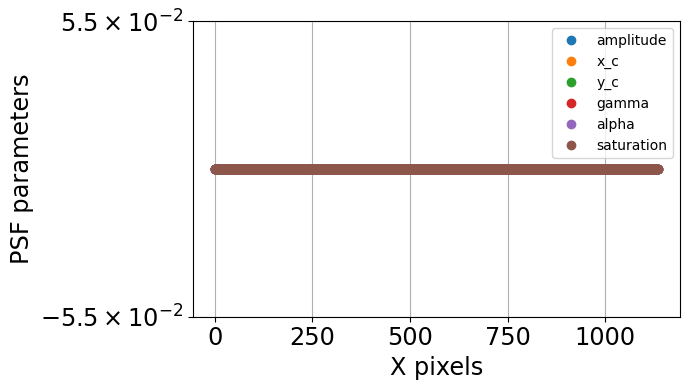

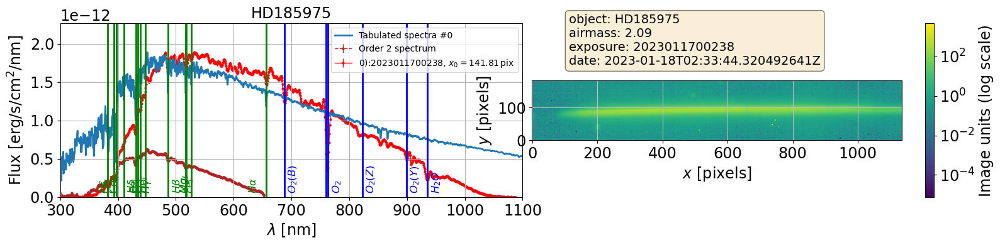

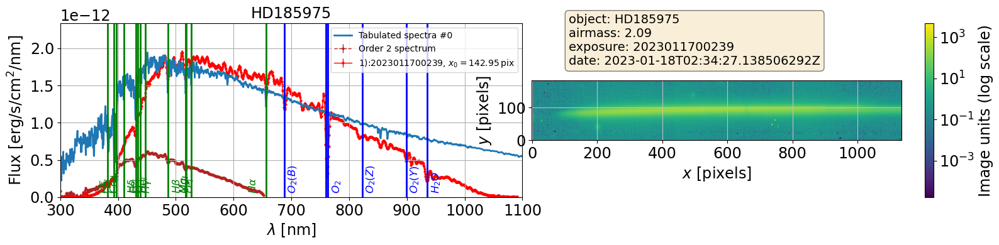

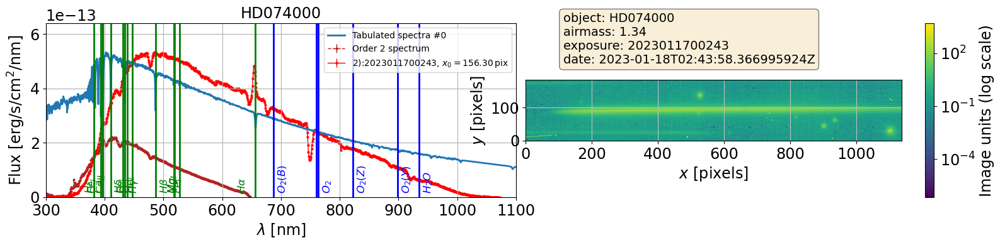

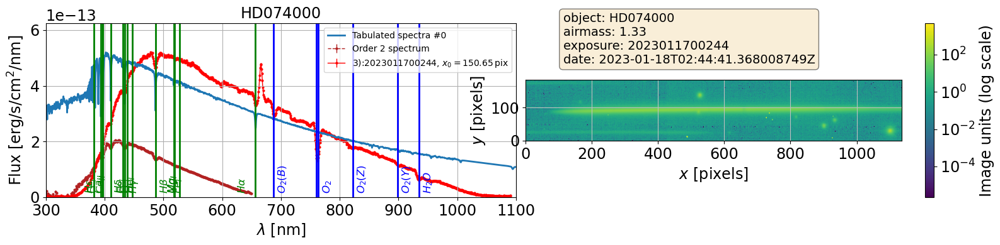

...

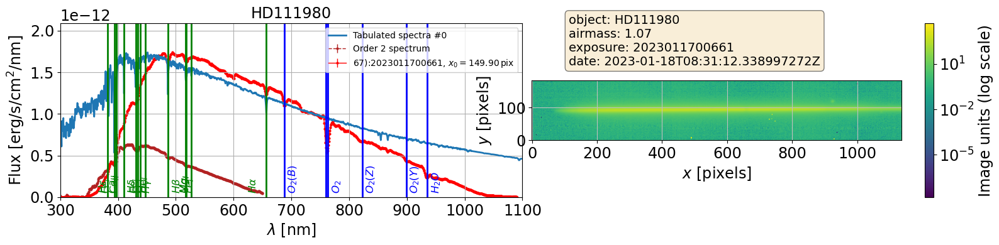

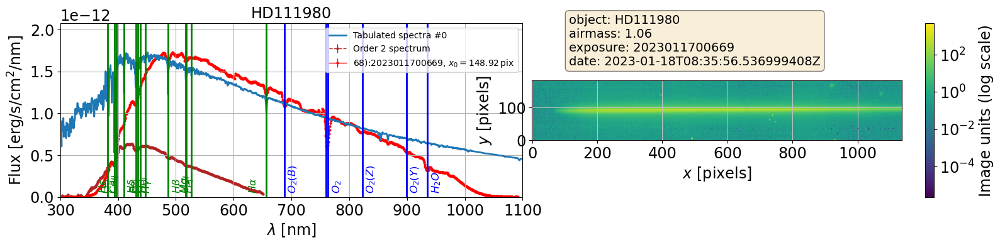

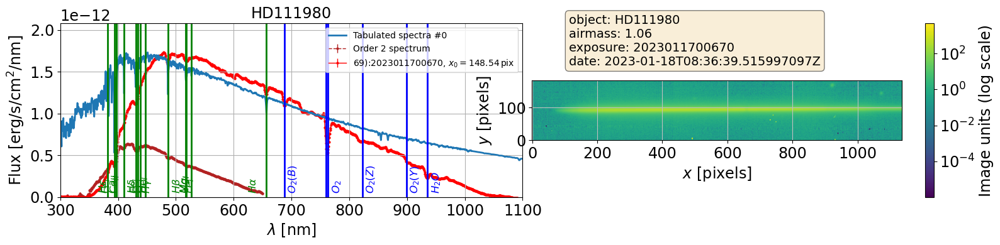

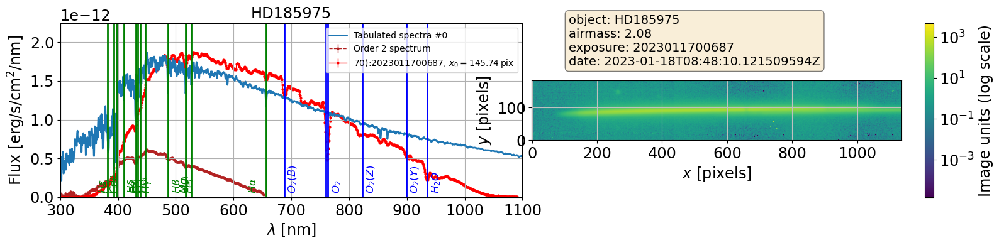

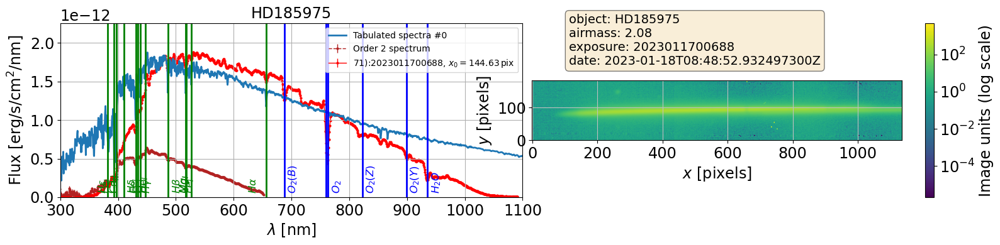

In [55]:
%matplotlib inline

infos = []
all_lambdas=[]
all_data=[]
all_data_err=[]
all_textstr = []



# loop on spectra
for index in range(NSPEC):
    
    idx = rank[index]
    s=all_spec[idx]
    label = str(index) +"):" + str(all_exposures[idx])
    the_expos = all_exposures[idx]
    
    try:
        fig=plt.figure(figsize=(16,4))
        
       
        textstr = '\n'.join((f"object: {s.target.label}", f"airmass: {s.airmass:.2f}",f"exposure: {the_expos}",f"date: {s.date_obs}"))
    
        ax1 = fig.add_subplot(1, 2, 1)
        s.plot_spectrum(ax=ax1,force_lines=True,label=label)
    
        ax2 = fig.add_subplot(1, 2, 2)
        s.plot_spectrogram(ax=ax2,scale="log")
        ax2.text(0.1, 2.1, textstr, transform=ax2.transAxes, fontsize=14,verticalalignment='top', bbox=props)
    
        all_lambdas.append(s.lambdas)
        all_data.append(s.data)
        all_data_err.append(s.err)
    
        #save info    
        infos.append([idx,s.target.label,s.date_obs,s.airmass,s.temperature,s.pressure,s.humidity])
        all_textstr.append(textstr)
        
        
            
    except Exception as inst:
        print(" >>> Exception catched for "+ label )
        print(type(inst))    # the exception instance
        print(inst.args)     # arguments stored in .args

    
    idx+=1

# Save plot in pdf file

In [56]:
from matplotlib.backends.backend_pdf import PdfPages

In [57]:
def SaveFigSpectraInPdf(nbspecperpage=5):
    
    Nspec= len(all_spec)
    Nbpages = np.ceil(Nspec/nbspecperpage)
    idx_inpage = nbspecperpage
    idx_pagenum = 0
    idx = 0
    
    all_composed_figs = []
    
    # loop on spectra
    for index in range(Nspec):  
        
        # get index on spectrum
        idx = rank[index]
        textstr = all_textstr[index]
   
        # if we need to start a new page
        if idx_inpage == nbspecperpage:
            idx_inpage = 1  # start at the first row in the page from 1 to nbspecperpage
            idx_pagenum += 1  # increase page counter
            
            # this trigger the saving of the whole figure (including all spectra of the page)
            if idx_pagenum > 1:
                plt.show()
                all_composed_figs.append(fig)
            
            # this create a new figure 
            fig=plt.figure(figsize=(16,20))
            
        # this is not a new page, need to increase the row number inside this page from 1 to nbspecperpage    
        else:
            idx_inpage += 1   
        
        # index of the figure in the page
        idx_fig = 2*(idx_inpage-1)+1
        
        print(f"\t \t  SaveFigSpectraInPdf >>>>>>>>  spec num = {index}, pagenum = {idx_pagenum}/{Nbpages}, idx_inpage = {idx_inpage}, idx_fig = {idx_fig}")        
       
    
        # Get the spectrum          
        s=all_spec[idx]
        label = str(index) +"):" + str(all_exposures[idx])
        
        # left image, two columns
        ax1 = fig.add_subplot(nbspecperpage, 2, idx_fig)
        s.plot_spectrum(ax=ax1,force_lines=True,label=label)
    
        #right image, to columns
        ax2 = fig.add_subplot(nbspecperpage, 2, idx_fig+1)
        s.plot_spectrogram(ax=ax2,scale="log")
        ax2.text(0.1, 2.1, textstr, transform=ax2.transAxes, fontsize=14,verticalalignment='top', bbox=props)
        
        
             
                           
    return  all_composed_figs
    


	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 0, pagenum = 1/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 1, pagenum = 1/15.0, idx_inpage = 2, idx_fig = 3


/home/d/dagoret/repos/repos_w_2023_35/Spectractor/lib/python/spectractor/extractor/spectrum.py:436: UserWarning: The figure layout has changed to tight
  plt.gcf().tight_layout()


	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 2, pagenum = 1/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 3, pagenum = 1/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 4, pagenum = 1/15.0, idx_inpage = 5, idx_fig = 9


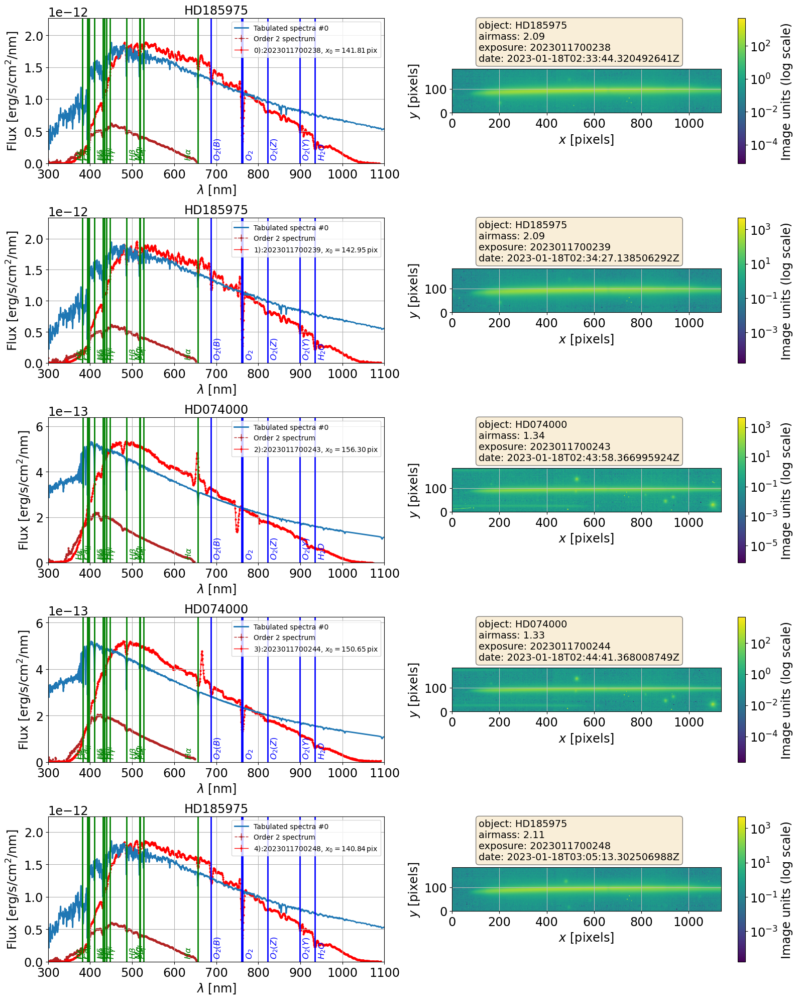

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 5, pagenum = 2/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 6, pagenum = 2/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 7, pagenum = 2/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 8, pagenum = 2/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 9, pagenum = 2/15.0, idx_inpage = 5, idx_fig = 9


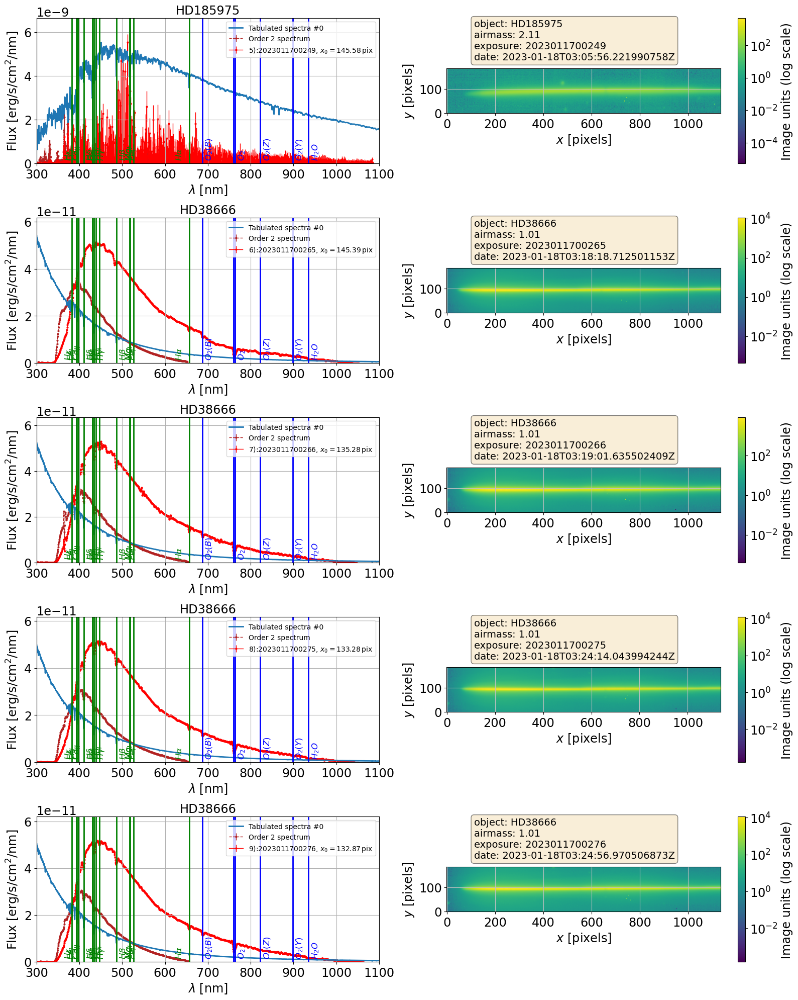

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 10, pagenum = 3/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 11, pagenum = 3/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 12, pagenum = 3/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 13, pagenum = 3/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 14, pagenum = 3/15.0, idx_inpage = 5, idx_fig = 9


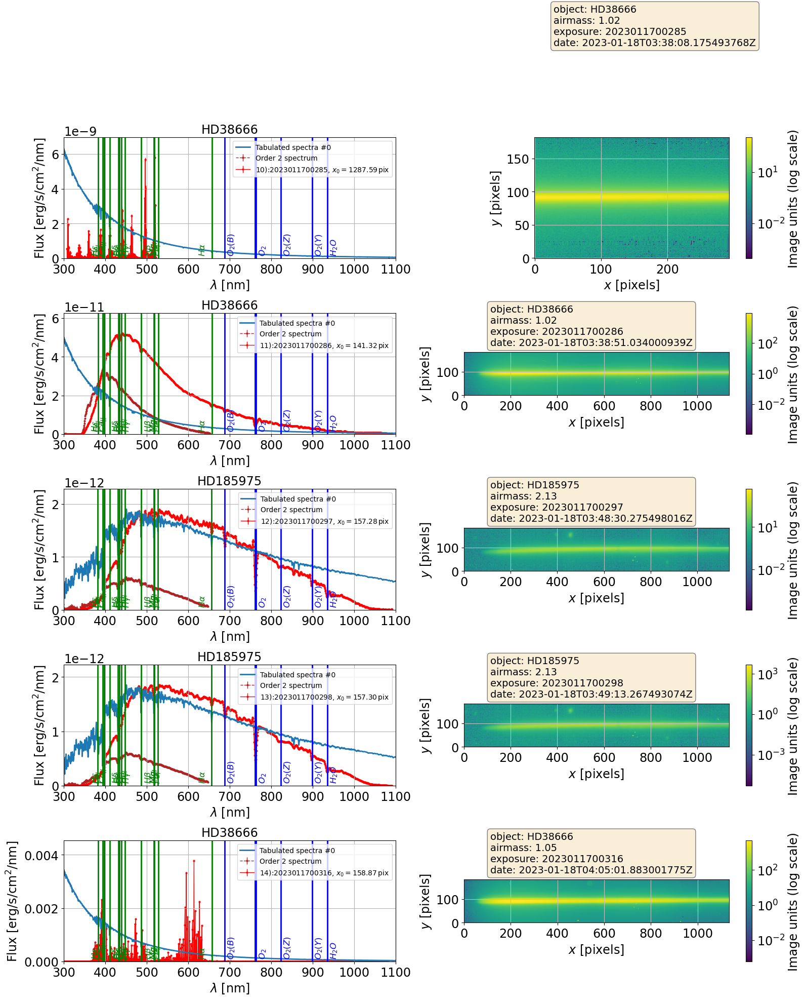

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 15, pagenum = 4/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 16, pagenum = 4/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 17, pagenum = 4/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 18, pagenum = 4/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 19, pagenum = 4/15.0, idx_inpage = 5, idx_fig = 9


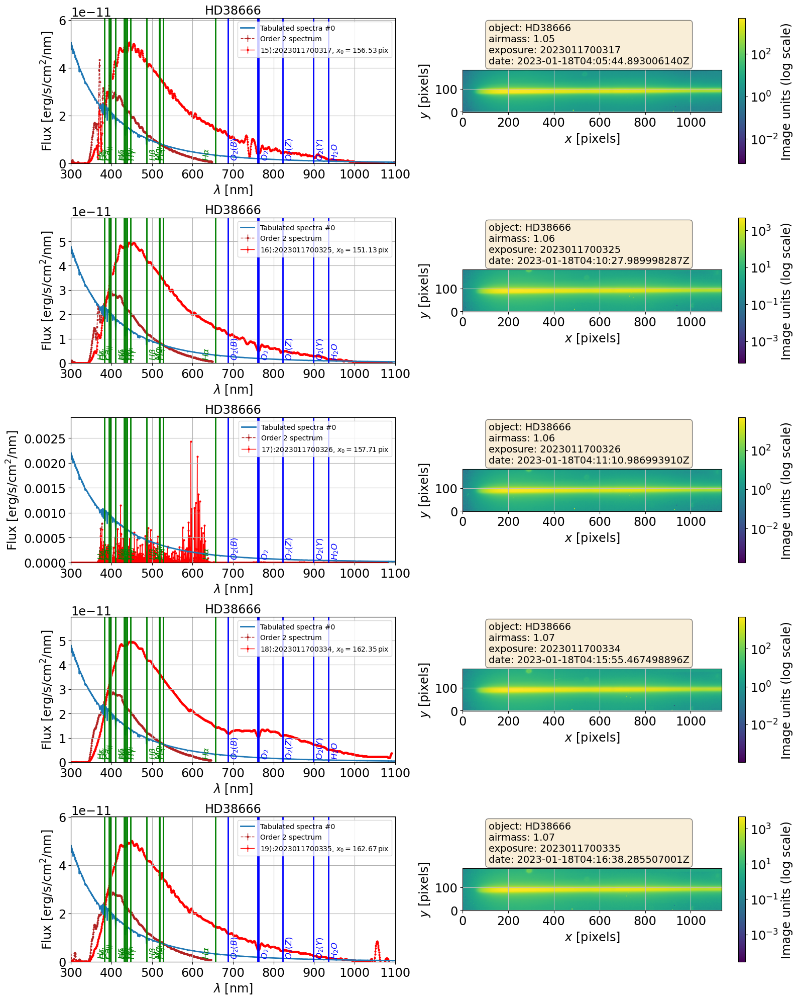

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 20, pagenum = 5/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 21, pagenum = 5/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 22, pagenum = 5/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 23, pagenum = 5/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 24, pagenum = 5/15.0, idx_inpage = 5, idx_fig = 9


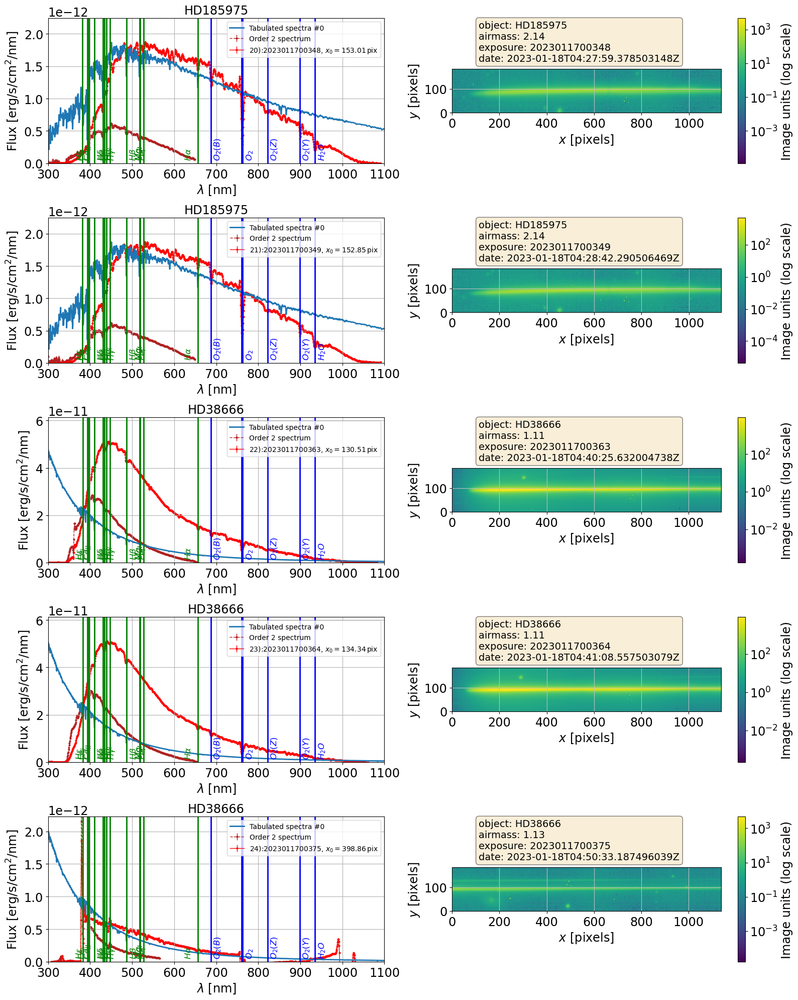

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 25, pagenum = 6/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 26, pagenum = 6/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 27, pagenum = 6/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 28, pagenum = 6/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 29, pagenum = 6/15.0, idx_inpage = 5, idx_fig = 9


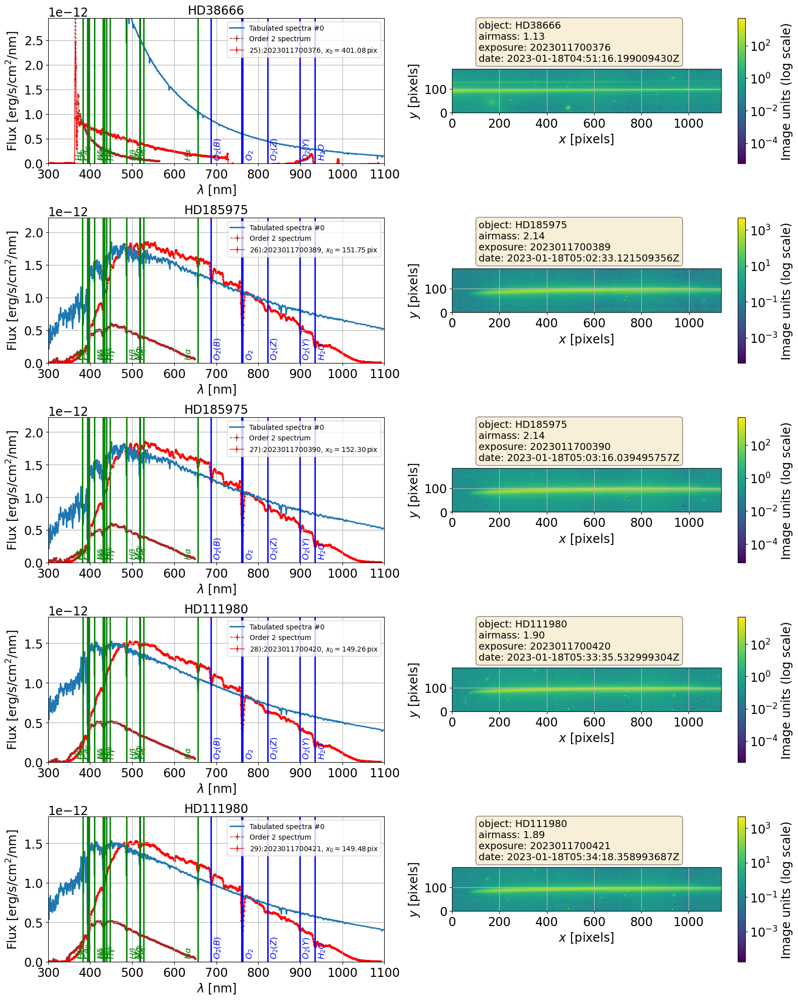

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 30, pagenum = 7/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 31, pagenum = 7/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 32, pagenum = 7/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 33, pagenum = 7/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 34, pagenum = 7/15.0, idx_inpage = 5, idx_fig = 9


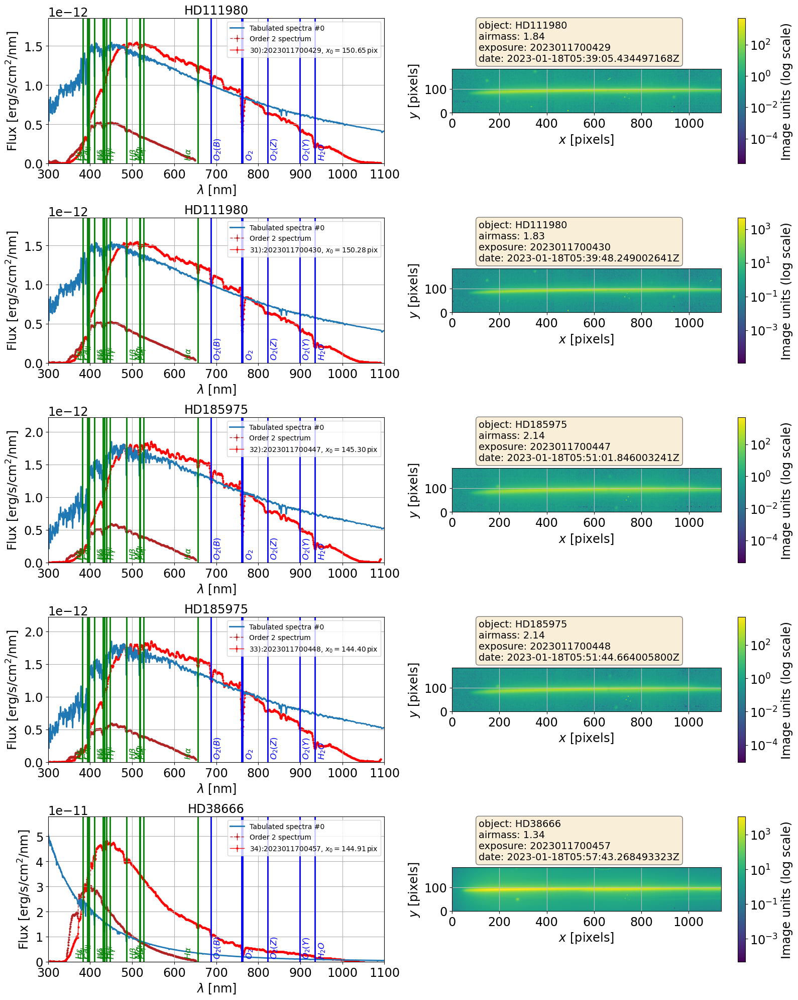

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 35, pagenum = 8/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 36, pagenum = 8/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 37, pagenum = 8/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 38, pagenum = 8/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 39, pagenum = 8/15.0, idx_inpage = 5, idx_fig = 9


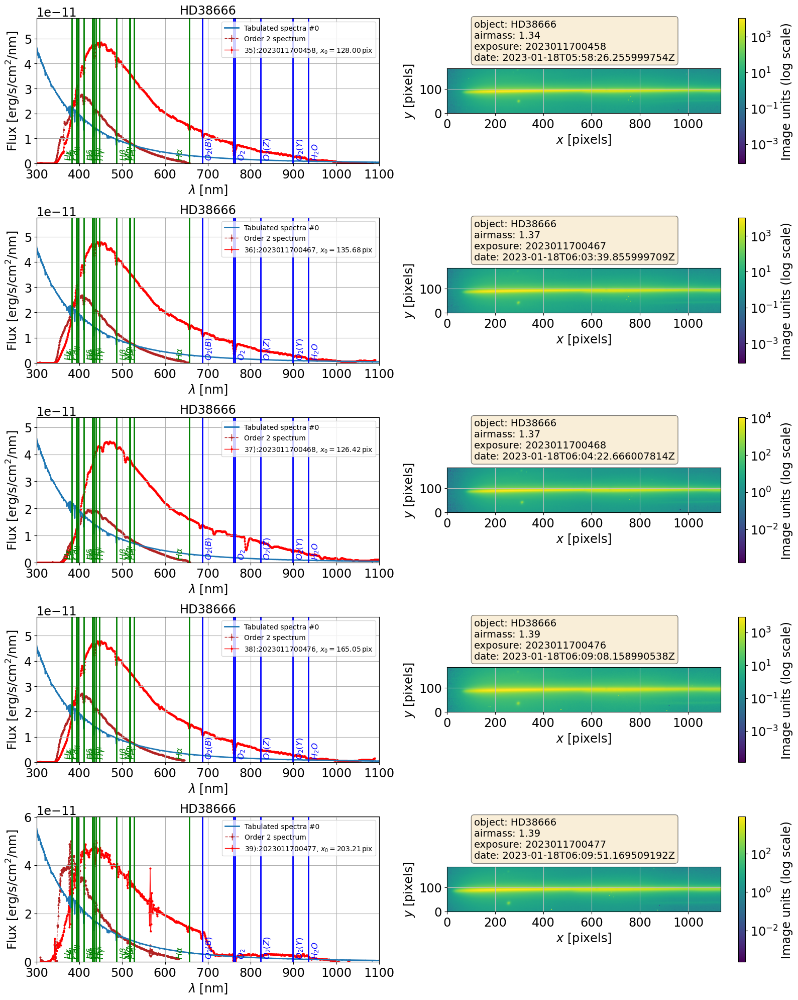

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 40, pagenum = 9/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 41, pagenum = 9/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 42, pagenum = 9/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 43, pagenum = 9/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 44, pagenum = 9/15.0, idx_inpage = 5, idx_fig = 9


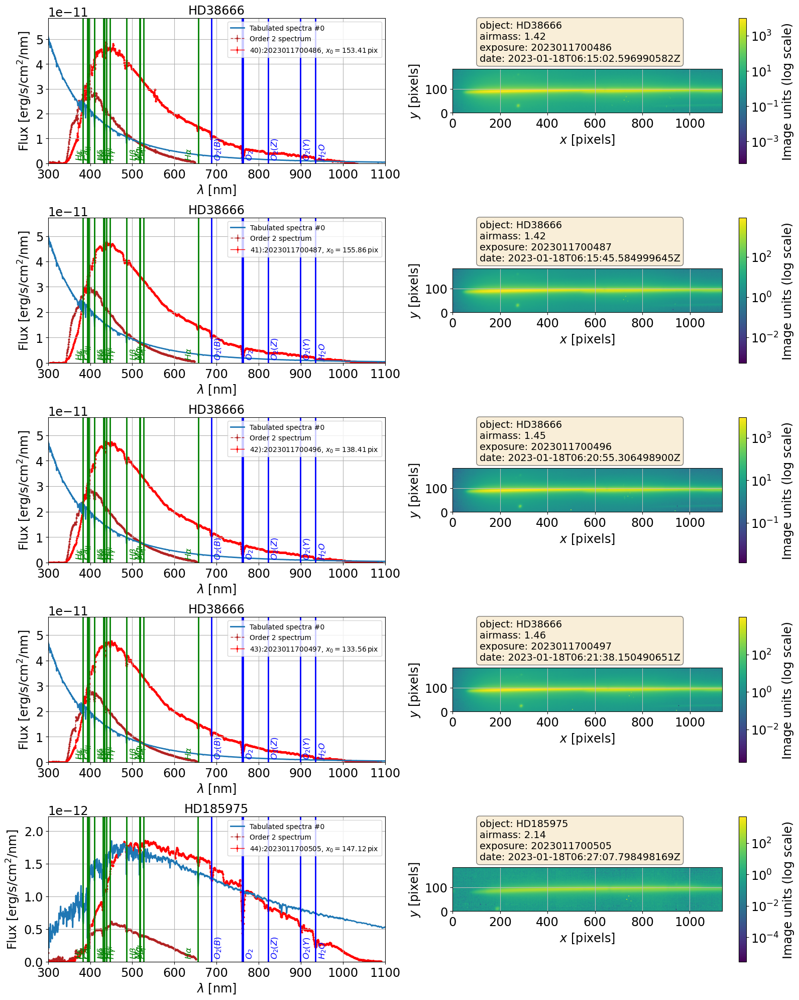

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 45, pagenum = 10/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 46, pagenum = 10/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 47, pagenum = 10/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 48, pagenum = 10/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 49, pagenum = 10/15.0, idx_inpage = 5, idx_fig = 9


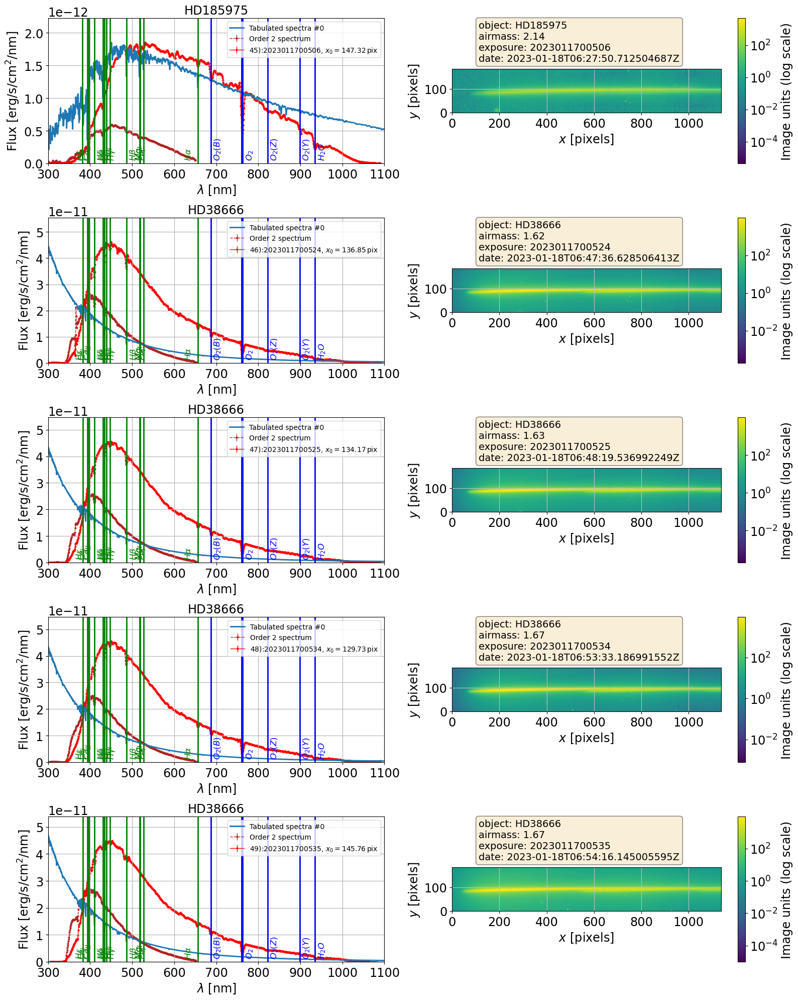

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 50, pagenum = 11/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 51, pagenum = 11/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 52, pagenum = 11/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 53, pagenum = 11/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 54, pagenum = 11/15.0, idx_inpage = 5, idx_fig = 9


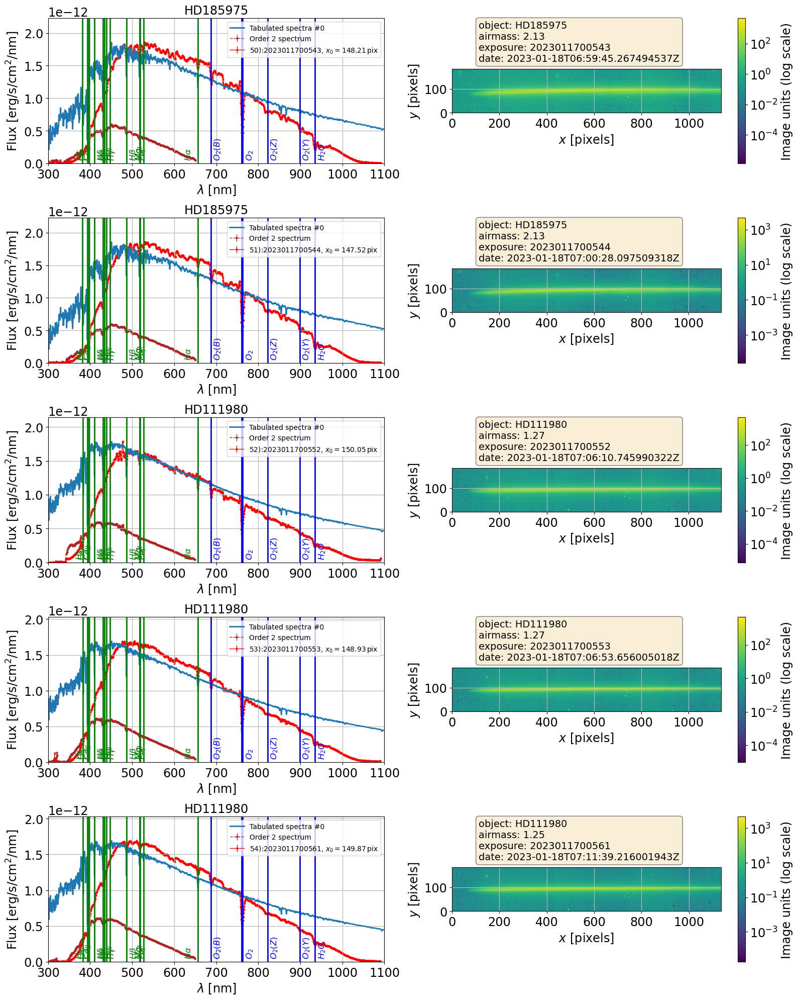

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 55, pagenum = 12/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 56, pagenum = 12/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 57, pagenum = 12/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 58, pagenum = 12/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 59, pagenum = 12/15.0, idx_inpage = 5, idx_fig = 9


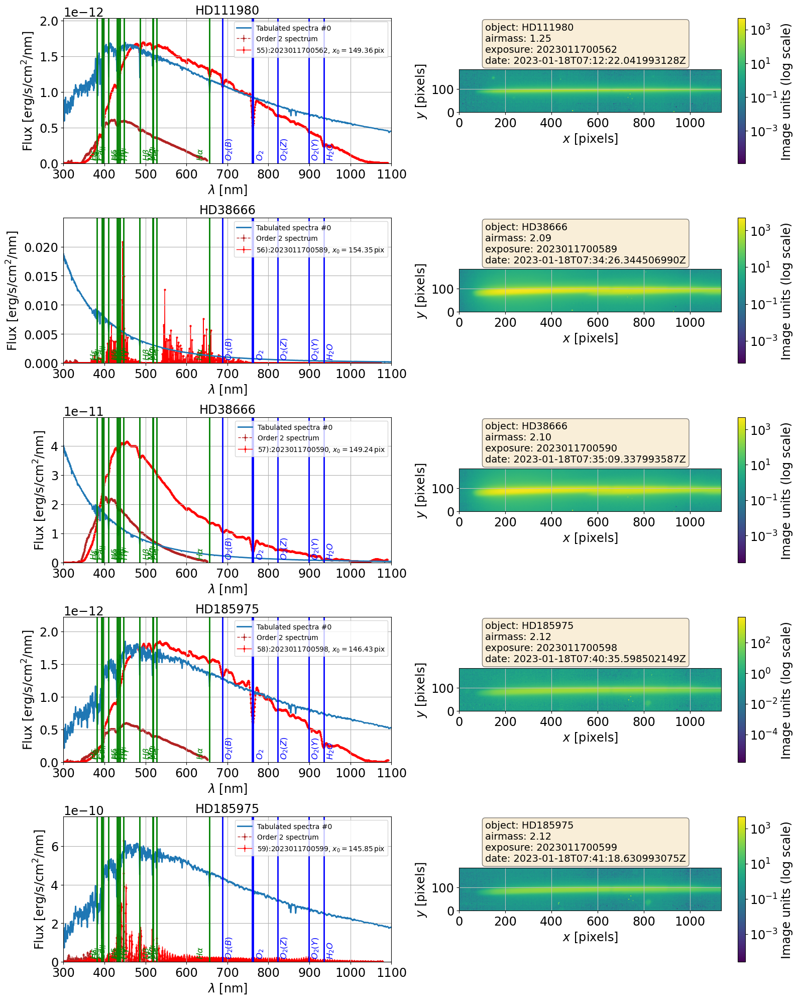

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 60, pagenum = 13/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 61, pagenum = 13/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 62, pagenum = 13/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 63, pagenum = 13/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 64, pagenum = 13/15.0, idx_inpage = 5, idx_fig = 9


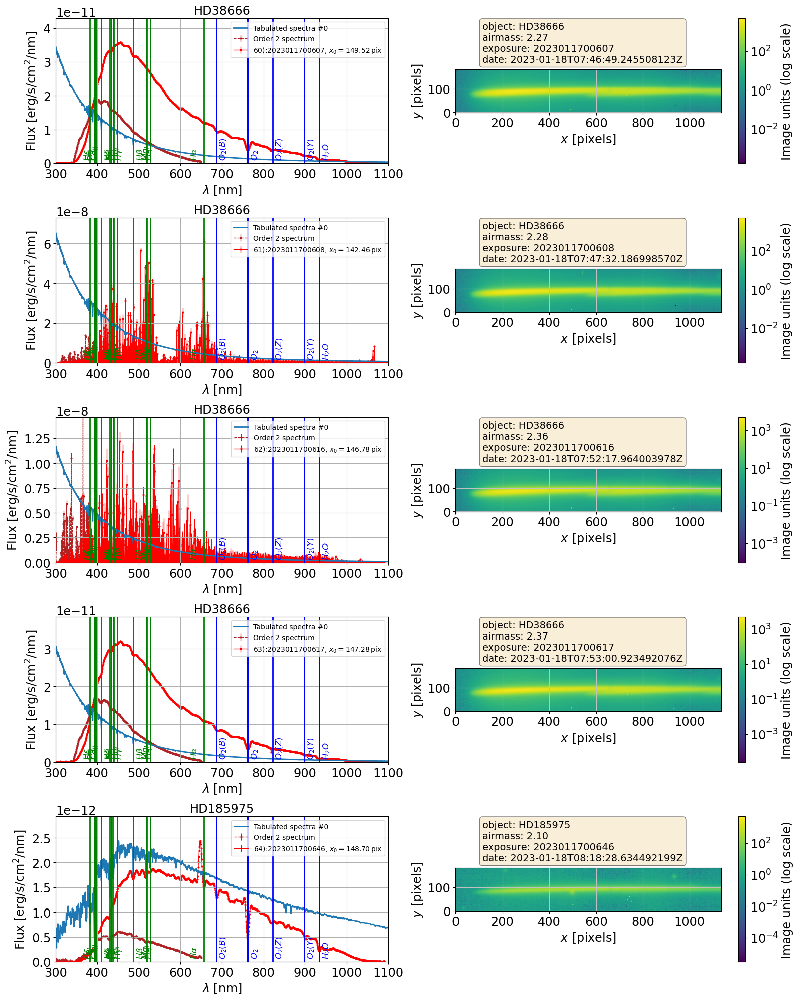

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 65, pagenum = 14/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 66, pagenum = 14/15.0, idx_inpage = 2, idx_fig = 3
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 67, pagenum = 14/15.0, idx_inpage = 3, idx_fig = 5
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 68, pagenum = 14/15.0, idx_inpage = 4, idx_fig = 7
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 69, pagenum = 14/15.0, idx_inpage = 5, idx_fig = 9


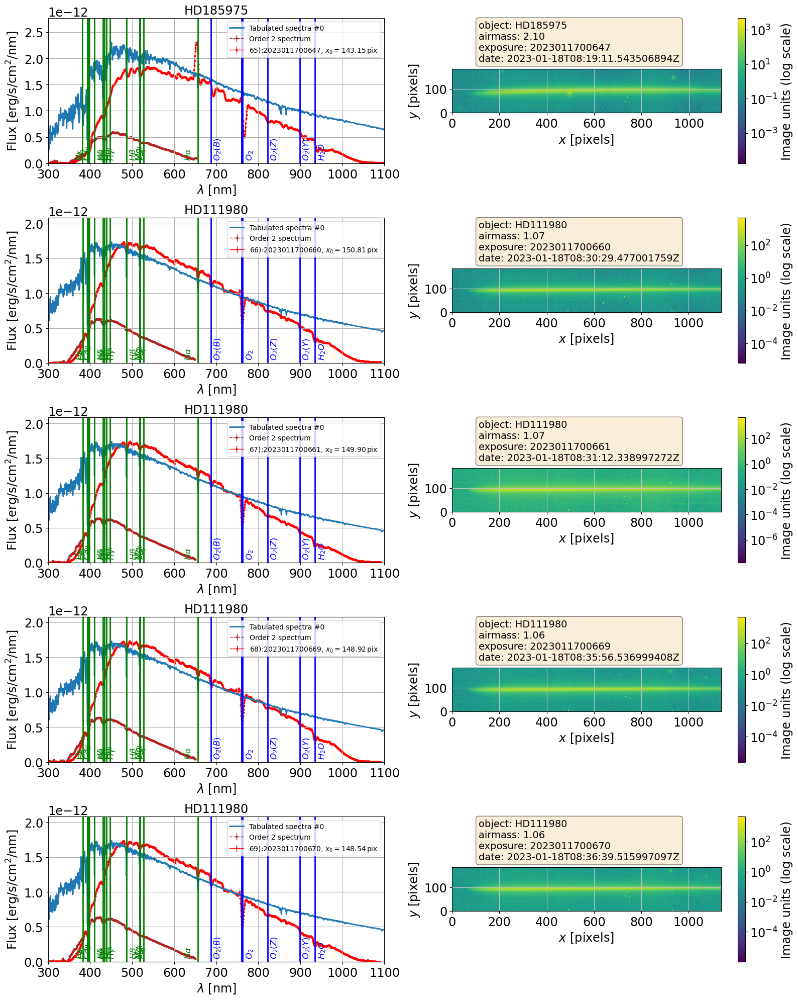

	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 70, pagenum = 15/15.0, idx_inpage = 1, idx_fig = 1
	 	  SaveFigSpectraInPdf >>>>>>>>  spec num = 71, pagenum = 15/15.0, idx_inpage = 2, idx_fig = 3


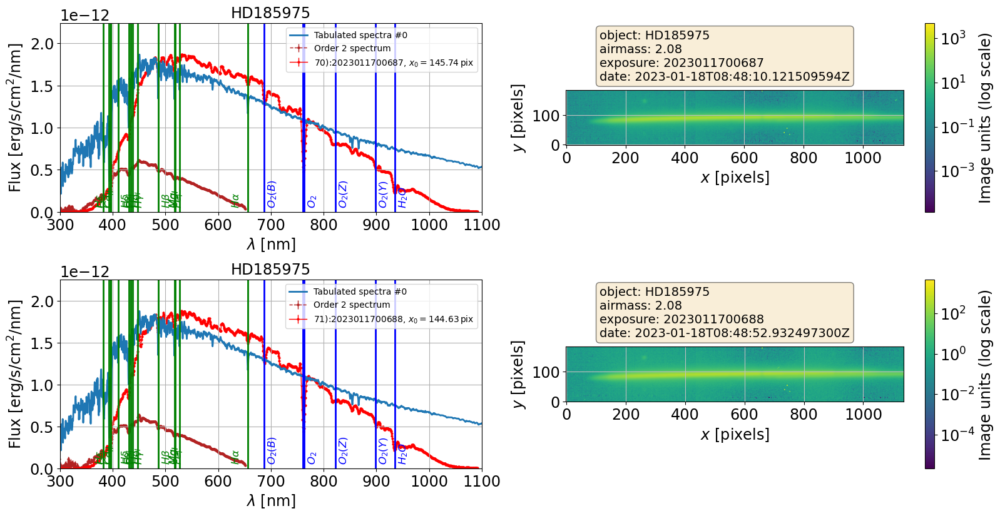

In [58]:
all_figs = SaveFigSpectraInPdf(nbspecperpage=5)

In [59]:
multipage_pdf_file = f'multipage_pdf_spectra_holo_{DATE}-{filterdispersername}-{configmode}-{specver}.pdf'

In [60]:
# gerate a multipage pdf:
with PdfPages(multipage_pdf_file) as pdf:
    for fig in all_figs:
        pdf.savefig(fig)
        plt.close()